# 基于 Unsplash API 的图片搜索与颜色聚类

这周的项目我想通过课程里学的api来延展一个交互页面，可以帮助人们检索不同颜色的花纹或者图案纹理。我在图片检索网站unsplash创建了一个免费的api，它允许我每小时发出50次请求。


## 1. 依赖库与项目结构

在本项目中，我使用了以下库：
- `streamlit`：用于快速构建交互式网页应用；
- `requests`：用于与 Unsplash API 进行 HTTP 请求交互；
- `numpy`、`cv2`、`sklearn.cluster`（KMeans）、`skimage`：用于图像处理和聚类分析；
- `PIL`：用于图像的读取与简单处理。


In [1]:
# app.py (Streamlit 主脚本)

import streamlit as st
import requests
import numpy as np
import cv2
from sklearn.cluster import KMeans
from skimage import color
from io import BytesIO
from PIL import Image

print("Libraries imported successfully.")

## 2. 自定义前端样式与主标题

我简单实现了我的页面交互功能：
图片示例：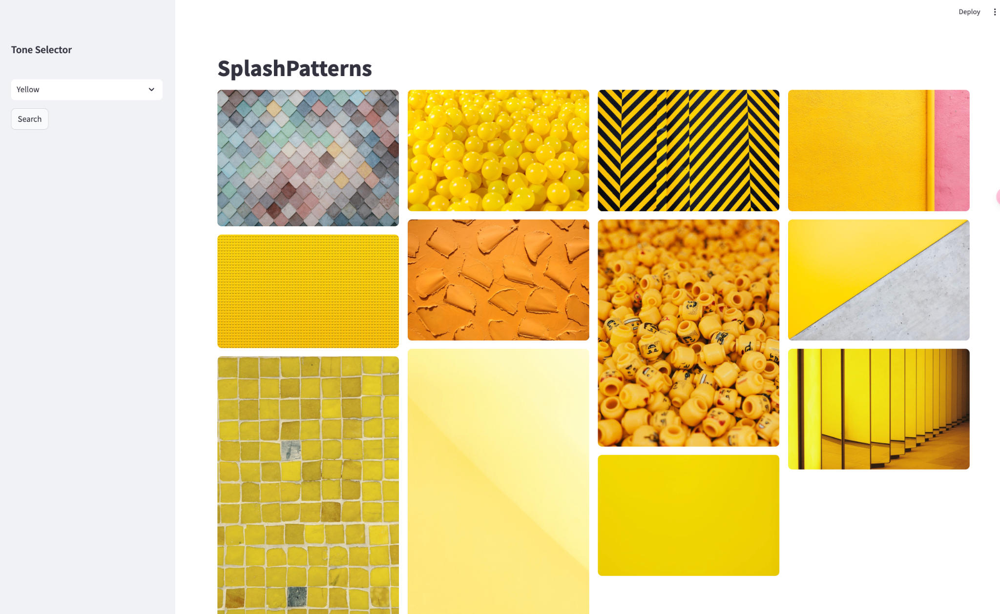


我认为前端页面上几点需要优化：

1.Tone sector 的标题层级不明显；

2.右侧图片网格排列不均衡；

3.标题的层级和字号需要更突出。

为解决上述问题，我通过注入自定义 CSS 来优化了 Streamlit 的前端数据可视化效果，例如给侧边栏添加背景色和阴影，将主标题居中加粗，以提升页面的视觉效果，使数据展示更加整洁清晰。









In [2]:
st.markdown("""
    <style>
    /* 给左侧Sidebar增加背景色与轻微阴影，以增强层次感 */
    [data-testid="stSidebar"] {
        background-color: #f8f9fa;
        box-shadow: 2px 0 5px rgba(0, 0, 0, 0.1);
    }

    /* 主标题样式：加大字号、字母间距、减少底部外边距 */
    .main-title {
        font-size: 3rem;        
        letter-spacing: 2px;    
        font-weight: 700;
        margin-bottom: 0.5rem;  
        text-align: center;     
    }

    /* 侧边栏标题的样式 */
    [data-testid="stSidebar"] h2 {
        font-size: 1.25rem;
        font-weight: 700;
        margin-bottom: 0.5rem;
        letter-spacing: 1px;
    }

    /* 下拉框与按钮之间的默认间距 */
    .stSelectbox, .stButton {
        margin-bottom: 1rem;
    }

    /* 优化按钮外观与尺寸 */
    .stButton > button {
        font-size: 16px;
        padding: 0.5rem 1.5rem; 
        border-radius: 4px;
        background-color: #cccccc; 
        color: #333;               
        border: none;
        transition: background-color 0.3s ease;
    }
    .stButton > button:hover {
        background-color: #bbbbbb;
    }
    </style>
""", unsafe_allow_html=True)

st.markdown("<h1 class='main-title'>SplashPatterns</h1>", unsafe_allow_html=True)


2025-03-12 16:32:14.230 WARNING streamlit.runtime.scriptrunner_utils.script_run_context: Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-12 16:32:14.333 
  command:

    streamlit run /opt/anaconda3/envs/aim/lib/python3.10/site-packages/ipykernel_launcher.py [ARGUMENTS]
2025-03-12 16:32:14.333 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-12 16:32:14.333 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-12 16:32:14.334 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.


DeltaGenerator()

【输出示例】：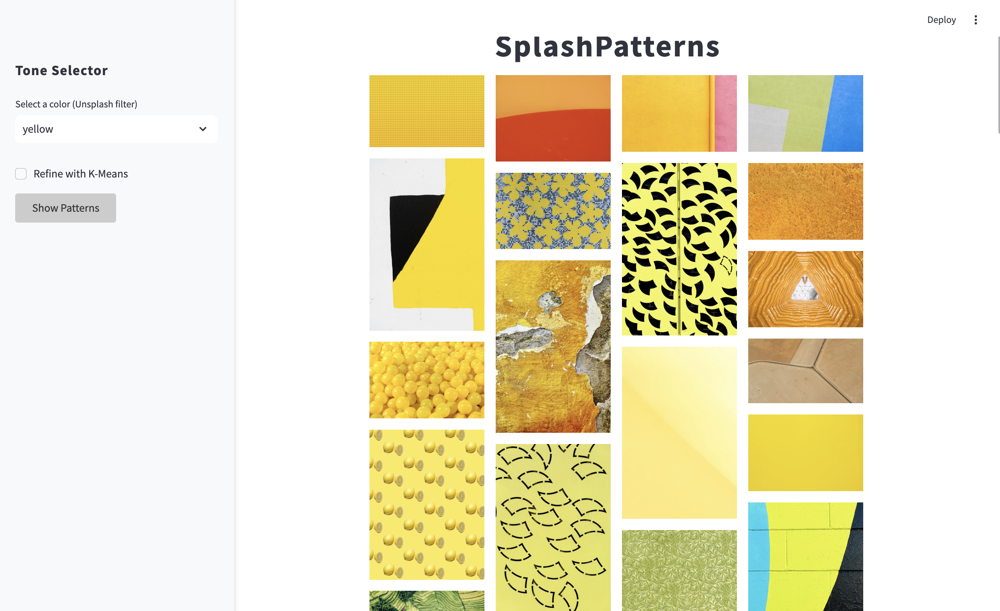
- 在浏览器中访问 `localhost:8501` 时，主标题居中加粗；
- 侧边栏有浅灰背景和阴影，按钮悬停时颜色会变化。


## 3. Unsplash API 调用与数据获取

我封装了一个函数，用于通过 Unsplash API 进行单页图片搜索。该函数使用 requests.get 发起请求，解析返回的 JSON 数据，提取每张图片的 regular 尺寸 URL。如果调用时提供了颜色参数，函数还会利用 Unsplash API 内置的颜色过滤功能。这样可以为应用程序提供一个简洁易用的接口，方便后续对图片的展示或进一步处理。

In [3]:
UNSPLASH_ACCESS_KEY = "cV2Slomwnm9YY0dp_lRF40J2QGatJfmmPxwJyzyZIlA"  # 请替换为你自己的 Access Key
UNSPLASH_SEARCH_URL = "https://api.unsplash.com/search/photos"

def search_unsplash_single_page(query, per_page=24, page=1, color=None):
    """
    在 Unsplash 上搜索单页图片，返回 'regular' 图片 URL 列表。
    如果传入 color 参数，则会使用 Unsplash 的内置 color 筛选。
    """
    headers = {"Authorization": f"Client-ID {UNSPLASH_ACCESS_KEY}"}
    params = {
        "query": query,
        "page": page,
        "per_page": per_page
    }
    if color:
        params["color"] = color

    try:
        response = requests.get(UNSPLASH_SEARCH_URL, headers=headers, params=params)
        if response.status_code != 200:
            st.warning(f"Unsplash API 返回错误: {response.status_code}")
            return []
        data = response.json()
    except Exception as e:
        st.error(f"请求 Unsplash API 出错: {e}")
        return []

    image_urls = []
    for item in data.get("results", []):
        url = item.get("urls", {}).get("regular")
        if url:
            image_urls.append(url)
    return image_urls

print("search_unsplash_single_page function defined.")

search_unsplash_single_page function defined.


## 4. 侧边栏输入与 Session State

我创建了一个侧边栏用来帮助用户进行简单的图片筛选，用户可以通过下拉菜单选择一个特定的颜色，然后unsplash的api内置颜色过滤功能会进行筛选。


In [ ]:
# ========== 4. 侧边栏输入和选择 ========== #
st.sidebar.header("Tone Selector")

# 用户仅能选择颜色与是否使用 K-Means 进行二次筛选
colors = [
    "None", "black_and_white", "black", "white", "yellow", "orange",
    "red", "purple", "magenta", "green", "teal", "blue"
]
selected_color = st.sidebar.selectbox("Select a color (Unsplash filter)", colors)


但是我发现即使指定了color= white实际的用户检索不太准确，我在下拉菜单里选择了white但是出来的图片往后加载还是有蓝色，彩色，甚至黑色的。这是搜索算法的局限，图片标记是人工或者算法生成，不可避免会有偏差或容差。

图片示例：

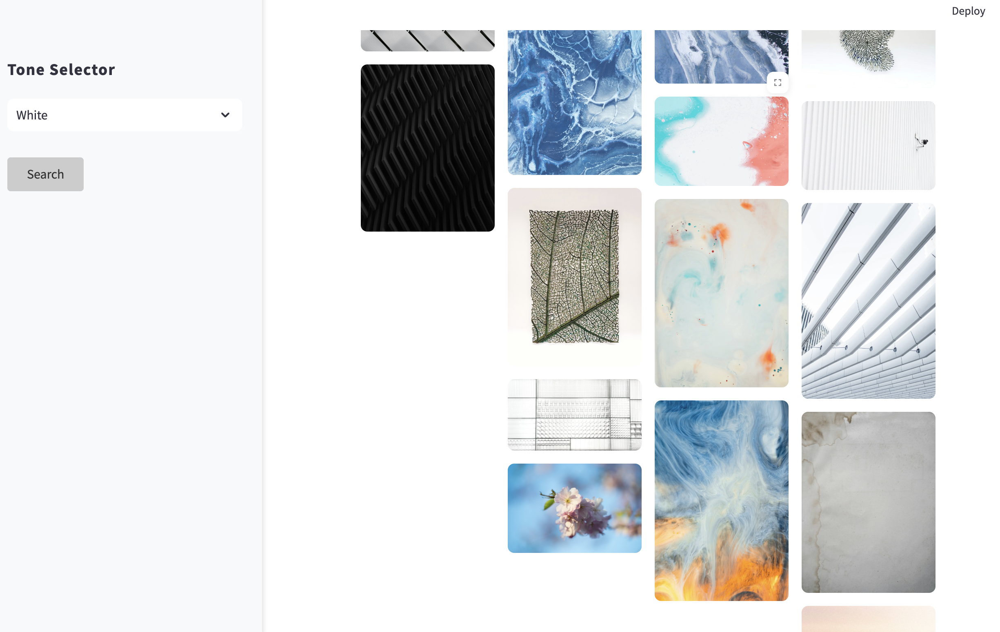





为什么会这样？，这涉及到算法自动识别的局限性，unsplash或者拍摄者在对图片打标时，可能会因为图片中出现白色元素，就将其标记为白色，但其实整体图像包含更多颜色。同时也涉及搜索引擎的容差，为了提供更多选择给用户，搜索算法会有一定的宽容度，并不会严格排除其他颜色的图片。

我想利用在应用无监督学习了解到的用k-means进行颜色聚类，是我添加了一个复选框，用于比较聚类前后颜色的准确状态。

In [5]:
refine_color = st.sidebar.checkbox("Refine with K-Means")

2025-03-15 13:52:03.064 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:52:03.065 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:52:03.065 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:52:03.066 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:52:03.067 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.


初始化 Streamlit 应用的状态（Session State）：若状态中未定义 "images" 键，则创建空列表以存储图片数据；若未定义 "page" 键，则初始化为 1，用于记录当前页码。通过明确初始状态，防止后续操作因缺失变量而产生错误。

In [6]:
# ========== 5. Session State 初始化 ========== #
if "images" not in st.session_state:
    st.session_state["images"] = []
if "page" not in st.session_state:
    st.session_state["page"] = 1

print("Sidebar inputs and session state initialized.")

2025-03-15 13:52:04.439 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:52:04.440 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.


Sidebar inputs and session state initialized.


## 5. 加载图片函数与“Search”按钮逻辑

这里我定义了一个图片加载函数 load_images，用于从 Unsplash API 获取图片 URL，并存储到会话状态（st.session_state["images"]）中。默认的请求是pattern，这样就可以使我的交互页面搜索功能垂直在花纹/图案这一类型。

In [7]:
def load_images(color=None):
    """
    固定搜索关键词为 "pattern"，根据 session_state["page"] 获取图片，
    并追加到 session_state["images"] 中。
    """
    query = "pattern"
    new_urls = search_unsplash_single_page(
        query,
        per_page=24,
        page=st.session_state["page"],
        color=color
    )
    st.session_state["images"].extend(new_urls)



2025-03-15 13:52:07.699 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:52:07.700 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:52:07.701 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:52:07.702 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:52:07.703 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.


用户点击侧边栏的「Search」按钮后，代码会重置页面状态。按照用户的关键词和颜色选项，一次性调用API加载前三页图片数据，以便快速展示搜索结果。一开始我每次只请求unsplash的1页，每页24张，所以每次加载出来的图片很少，所以我用 for page_idx in range(1,4) 表示想一次取第 1～3 页，这样可以让用户一次性看到更多图片（72张）。

In [12]:
if st.sidebar.button("Show Patterns"):
    # 每次新搜索都重置
    st.session_state["page"] = 1
    st.session_state["images"] = []
    
    c = None if selected_color == "None" else selected_color
    # 加载前 3 页数据
    for page_idx in range(1, 4):
        st.session_state["page"] = page_idx
        load_images(color=c)


2025-03-15 13:53:36.436 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:53:36.437 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:53:36.439 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:53:36.440 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-15 13:53:36.441 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.


Search button logic executed.


## 6. K-Means 聚类进行二次色彩筛选

当用户已搜索到图片，并选择了「使用 K-Means 精细颜色筛选 (refine_color 勾选)」，且颜色不是默认的 "None" 时，进一步筛选并排序图片，使其更贴合用户所选颜色。通过定义颜色映射、颜色空间转换，使用k-means算法颜色聚类，颜色距离计算，在理论上可以根据颜色匹配度排序，更精准的匹配到颜色偏好。这里我先把k值设置为3

In [25]:
if st.session_state["images"]:
    if refine_color and selected_color != "None":
        # 这里写一些近似 RGB 值；更专业的实现可以使用更详细的颜色映射
        color_map = {
            "black": (0, 0, 0),
            "white": (1, 1, 1),
            "yellow": (1, 1, 0),
            "orange": (1, 0.65, 0),
            "red": (1, 0, 0),
            "purple": (0.5, 0, 0.5),
            "magenta": (1, 0, 1),
            "green": (0, 1, 0),
            "teal": (0, 0.5, 0.5),
            "blue": (0, 0, 1),
            "black_and_white": (0.5, 0.5, 0.5)
        }
        target_rgb = color_map.get(selected_color, (0.5, 0.5, 0.5))
        def rgb_to_lab(rgb):
            """ 将 (r, g, b) [0,1] 转成 Lab """
            arr = np.array(rgb).reshape(1, 1, 3)
            lab = color.rgb2lab(arr)
            return lab[0, 0, :]

        target_lab = rgb_to_lab(target_rgb)

        def get_dominant_color(img, k=3):
            """
            使用 K-Means 从图片提取最主要的颜色（取聚类中心之一）。
            返回值为 (r, g, b)，取 0-1 区间。
            """
            img = np.array(img.resize((100, 100)))
            img = img.reshape(-1, 3).astype(np.float32) / 255.0
            km = KMeans(n_clusters=k, random_state=42).fit(img)
            labels, counts = np.unique(km.labels_, return_counts=True)
            major_cluster = labels[np.argmax(counts)]
            dominant_rgb = km.cluster_centers_[major_cluster]
            return dominant_rgb

        def color_distance(c1, c2):
            """ 计算两种 Lab 颜色的欧氏距离 """
            return np.sqrt(np.sum((c1 - c2) ** 2))

        refined_data = []
        for url in st.session_state["images"]:
            try:
                resp = requests.get(url, timeout=5)
                if resp.status_code == 200:
                    img_pil = Image.open(BytesIO(resp.content)).convert("RGB")
                    dom_rgb = get_dominant_color(img_pil, k=3)
                    dist = color_distance(rgb_to_lab(dom_rgb), target_lab)
                    refined_data.append((url, dist))
            except Exception as e:
                # 下载失败或处理出错时跳过该图片
                pass

        # 根据颜色距离从小到大排序，并只保留前 N 张图片
        refined_data.sort(key=lambda x: x[1])
        top_n = 200
        refined_data = refined_data[:top_n]
        st.session_state["images"] = [x[0] for x in refined_data]


2025-03-15 14:19:02.236 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.


k值为3的时候示例输出对比

搜索白色不使用kmeans：
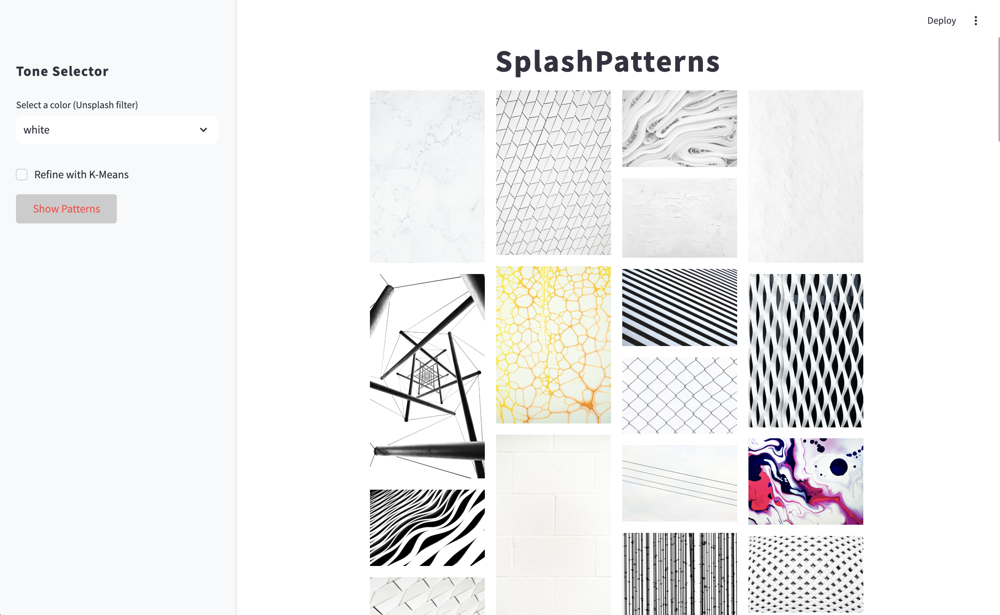

搜索白色使用kmeans优化(k=3)：
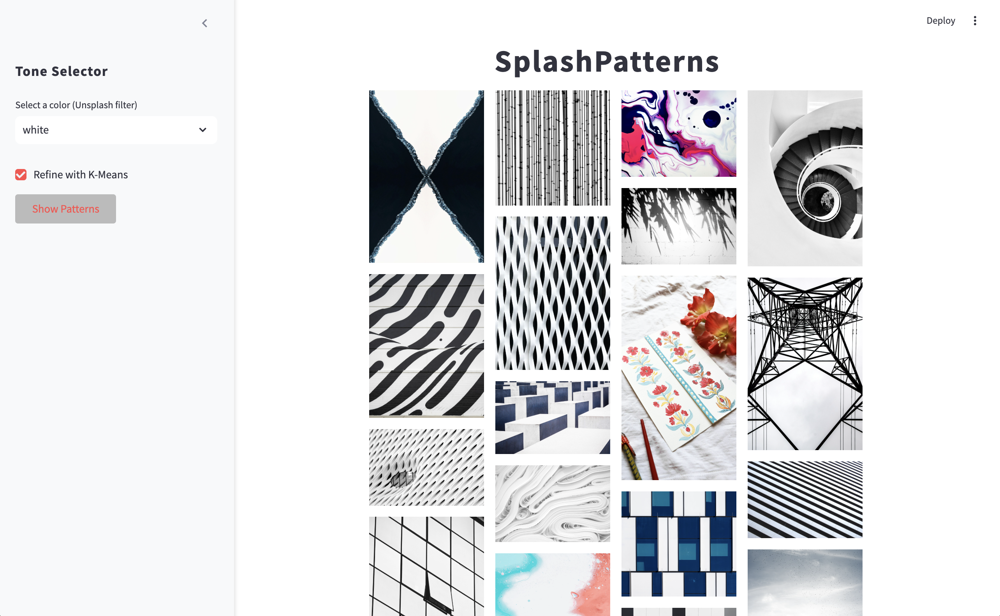


搜索红色不使用kmeans：
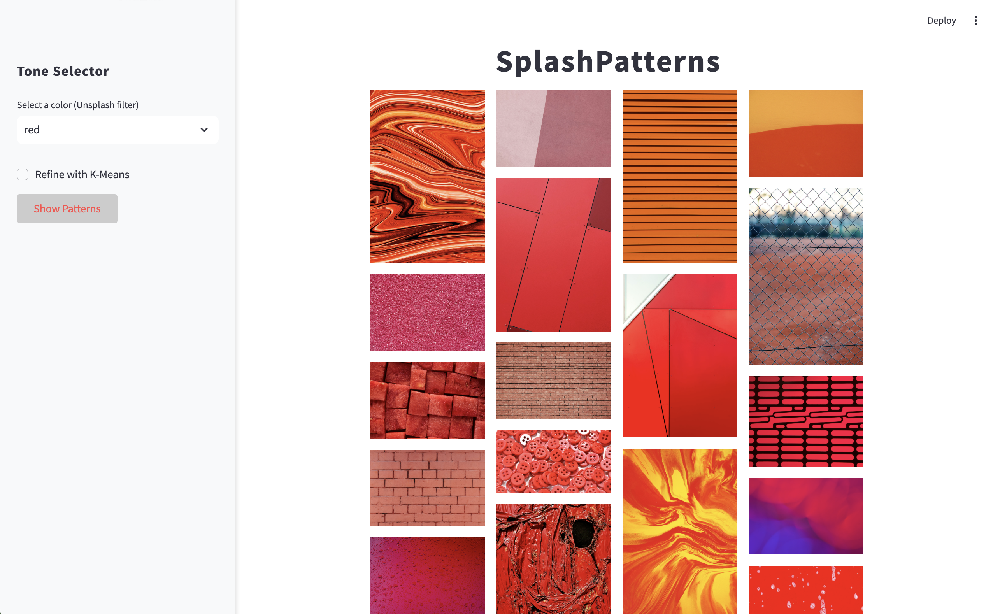

搜索红色使用kmeans优化（k=3）：
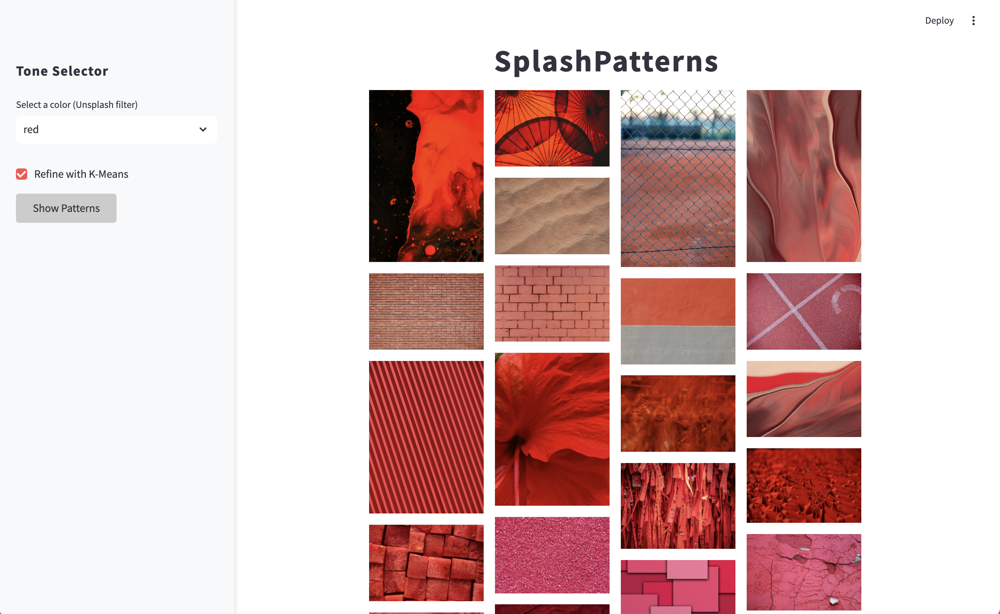


理论上来说，在api颜色过滤的基础上，额外通过kmeans聚类算法分析图片的主色调，从颜色空间计算与目标颜色的距离，这样可以使展示的图片色彩更加贴合用户的选择，但是结果表明并没哟体现出明显的优化效果，仍旧是一批图片，但是kmeans在unsplash的基础上可能是改变了这些图片的顺序，让算法上更加贴近颜色偏好的靠前。

原因可能是颜色聚类方法的参数或实现方式不够精准，kmeans聚类颜色提取的效果会受到聚类数量（k值），颜色本身的颜色复杂度和聚类时图像大小限制所影响，当前聚类数量（k=3）可能太少，无法准确反映图片的特征，所以我继续增加kmeans聚类的数量（k=8）增强颜色区分的精细程度。

输出示例：
搜索白色使用kmeans优化(k=1)：
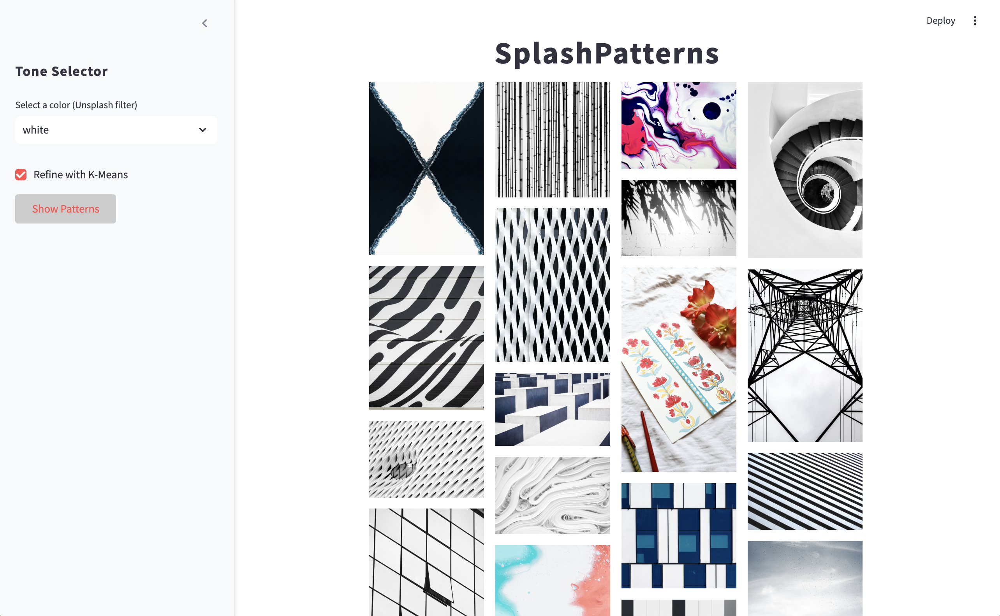
搜索白色使用kmeans优化（k=8）：
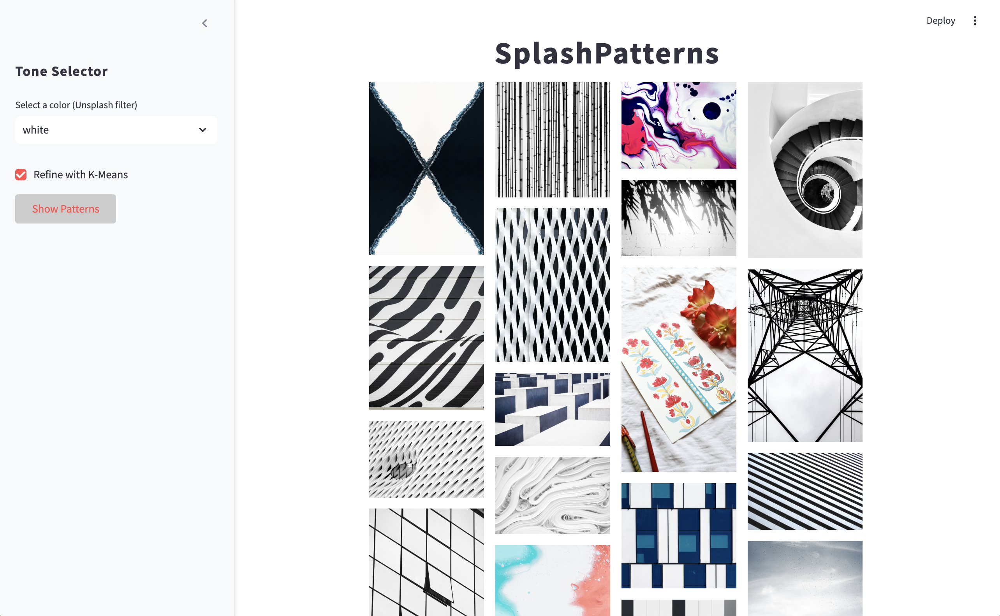

搜索红色使用kmeans优化（k=1）：
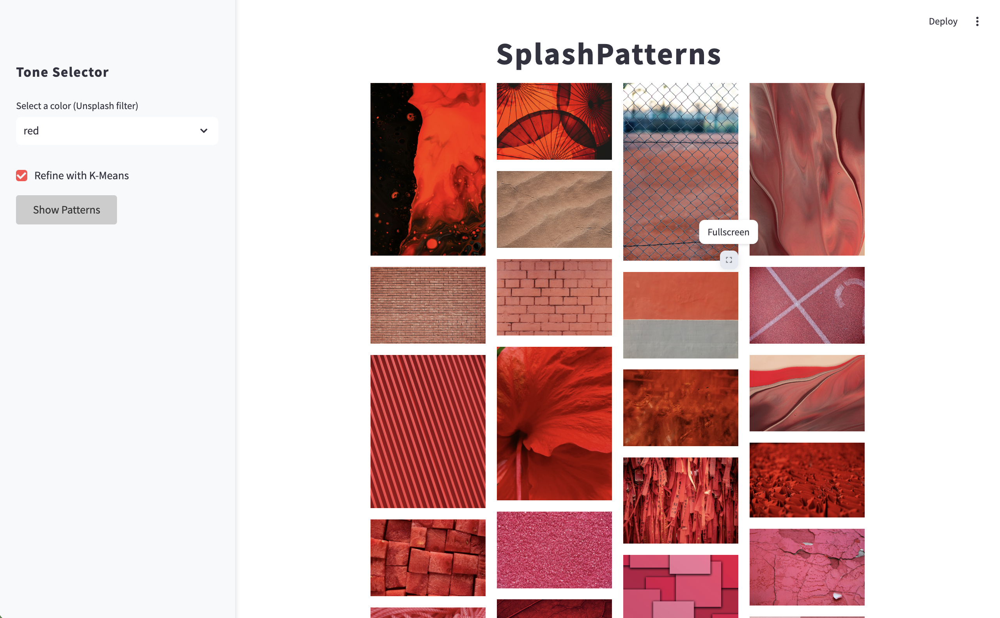

搜索红色使用kmeans优化（k=8）：
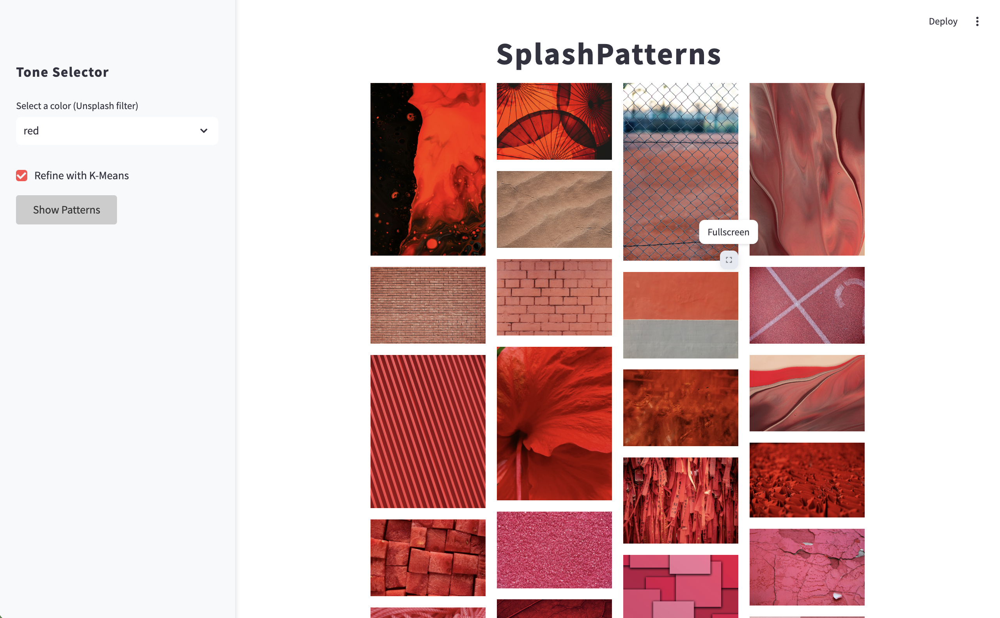

k值大小似乎没有影响kmeans筛选出的图片的结果

【反思】：
- 利用 K-Means 聚类提取图片主色是应用无监督学习的一个典型场景；
- 通过将 RGB 转换为 LAB 色空间，可以更符合人眼对颜色差异的感知；
- 该方法简单高效，但对背景复杂或多彩的图片精度有限，需要实验调整参数。

## 7. 显示图片、二次筛选与“Load More” 按钮

下面代码实现了：
- 如果用户勾选了“Refine with K-Means”，则会对获取到的图片进行二次筛选，保留与目标颜色距离最小的图片；
- 将图片以 4 列网格布局显示；
- 提供“Load More”按钮以加载更多图片。

【核心逻辑】：
- 对每张图片下载并提取主色，然后与用户选择的目标色做距离计算；
- 按色差排序并保留前 N 张；
- 利用 Streamlit 的列布局展示图片，并通过按钮实现分页加载。

In [7]:
if st.session_state["images"]:
    # 如果启用二次筛选
    if refine_color and selected_color != "None":
        color_map = {
            "black": (0, 0, 0),
            "white": (1, 1, 1),
            "yellow": (1, 1, 0),
            "orange": (1, 0.65, 0),
            "red": (1, 0, 0),
            "purple": (0.5, 0, 0.5),
            "magenta": (1, 0, 1),
            "green": (0, 1, 0),
            "teal": (0, 0.5, 0.5),
            "blue": (0, 0, 1),
            "black_and_white": (0.5, 0.5, 0.5)
        }
        target_rgb = color_map.get(selected_color, (0.5, 0.5, 0.5))
        target_lab = rgb_to_lab(target_rgb)

        refined_data = []
        for url in st.session_state["images"]:
            try:
                resp = requests.get(url, timeout=5)
                if resp.status_code == 200:
                    img_pil = Image.open(BytesIO(resp.content)).convert("RGB")
                    dom_rgb = get_dominant_color(img_pil, k=3)
                    dist = color_distance(rgb_to_lab(dom_rgb), target_lab)
                    refined_data.append((url, dist))
            except:
                pass

        # 按色差升序排序，保留前200张
        refined_data.sort(key=lambda x: x[1])
        top_n = 200
        refined_data = refined_data[:top_n]
        st.session_state["images"] = [x[0] for x in refined_data]

    # 网格显示图片，4 列布局
    num_cols = 4
    cols = st.columns(num_cols)
    for idx, url in enumerate(st.session_state["images"]):
        with cols[idx % num_cols]:
            st.image(url, use_container_width=True)

    # “Load More” 按钮
    if st.button("Load More"):
        st.session_state["page"] += 1
        c = None if selected_color == "None" else selected_color
        load_images(keyword, color=c)
else:
    if st.session_state["page"] == 1:
        st.write("No images to display. Please click 'Search' on the sidebar.")

print("Image display and load more logic executed.")

2025-03-12 16:33:43.933 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-12 16:33:43.934 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-12 16:33:43.935 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-12 16:33:43.935 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-12 16:33:43.936 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-03-12 16:33:43.936 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.


Image display and load more logic executed.


【输出结果与说明】：
- 浏览器中会显示一个 4 列的图片网格，每张图片为 Unsplash 提供的预览；
- 如果启用 K-Means 二次筛选，则图片列表会按与目标颜色的距离排序，距离较小的图片更接近目标色；
- 点击 “Load More” 按钮后，会加载下一页图片。

【反思】：
- 二次筛选能有效过滤掉不符合颜色要求的图片，但可能会减少总数；
- 下载和聚类处理会带来额外耗时，需要根据网络和设备性能权衡用户体验。

## 8. 数据科学过程与挑战

**工具与技术选择**：
- 我选择了 Streamlit 来快速构建交互界面，因为它上手快、交互性好；
- 使用 Unsplash API 获取高质量图片数据，但注意到其搜索精度并非 100%；
- 应用了 K-Means 聚类和 LAB 色空间转换，强化了我对无监督学习和图像处理的理解。

**遇到的挑战与解决方案**：
- **挑战1**：Unsplash color 参数返回结果不够精准。
  - 解决方案：使用更具体的关键词（如 "white background"）以及二次筛选（K-Means 聚类）。
- **挑战2**：分页加载数据时可能会导致响应时间较长。
  - 解决方案：采用分批加载方式，并使用 "Load More" 按钮控制加载频率。
- **挑战3**：K-Means 算法对复杂图像的准确性有限，需要多次实验调整参数。

**对数据与统计的理解变化**：
- 通过实践我发现第三方 API 的数据通常需要后续处理，不能直接用于分析；
- 颜色聚类作为典型的无监督学习方法，加深了我对统计与机器学习算法优缺点的理解。

**伦理与隐私思考**：
- 在使用第三方 API 时，我严格遵守了 Unsplash 的使用条款，尊重版权与限速限制；
- 在处理和存储数据时注意数据隐私和合规要求，避免过度抓取和数据滥用。

## 9. 后续拓展与改进

**未来改进方向**：
- 使用 HSV 或 LAB 进行更精细的像素级筛选，获取更纯的颜色；
- 替换“Load More”按钮为无限滚动加载，以改善用户体验；
- 拓展 API 来源（如 NASA、NewsAPI），实现多模态数据融合；
- 拆分前后端，实现 Flask/Django 后端服务，提升应用的可扩展性；
- 加入自动化测试与 CI/CD 流程，提高代码稳定性。

**自我反思**：
- 本项目让我对数据获取、图像处理、机器学习算法的实际应用有了更深入的认识；
- 我学会了如何在面对第三方 API 的不完美数据时，通过二次处理来补救；
- 此外，通过团队协作和代码模块化，我也认识到良好的项目管理对最终成果的重要性；
- 这些技能和经验将在我未来的艺术设计、摄影管理和创意实践中发挥重要作用。

## 10. 示例输出与成果展示

【屏幕截图说明】：
- **主界面截图**：展示了侧边栏（包含搜索关键词、颜色选择和 K-Means 复选框）和主页面的图片网格；
- **图片检索结果**：当我输入“blue pattern”并选择“blue”时，页面显示主要以蓝色调为主的图片；
- **二次筛选效果**：勾选“Refine with K-Means”后，输出结果中图片的主色更趋近于目标色；

【输出成果】：
- 我在项目中成功实现了图片的分页加载和颜色聚类二次筛选；
- 通过调试与测试，我记录下了多个阶段的屏幕截图和日志，证明了我对数据科学不同流程的理解与实践。

## 11. 结语

通过本项目，我完整展示了从 API 获取数据、前端交互、颜色聚类二次筛选到分页加载与用户体验改进的整个数据科学流程。

项目中不仅运用了机器学习聚类、图像处理、Web 应用开发等多项技能，同时也暴露了第三方 API 依赖、算法局限以及性能优化等实际问题。

在今后的学习和实践中，我会不断扩充和改进项目功能，探索更精确的图像分析方法和更高效的前后端协同开发方案，持续提升数据科学和创意应用的能力。